## MileStone 1

### Install dependencies

In [ ]:
!pip install -q condacolab
import condacolab
condacolab.install()

In [ ]:
!conda install transformers plotly openai langchain sentence-transformers ultralytics opencv segment-geospatial groundingdino-py segment-anything-fast pytorch torchvision cudatoolkit=11.1 -c pytorch -c nvidia -c conda-forge

### Load and view train and val data from hugging face

In [1]:
import os
import torch
from samgeo import SamGeo, tms_to_geotiff
from datasets import load_dataset
import io
from PIL import Image

In [3]:
# get data from hugging face
dataset = load_dataset("back2classroom/sidewalks")

/usr/local/lib/python3.10/site-packages/huggingface_hub/utils/_token.py:89: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


Generating train split:   0%|          | 0/180000 [00:00<?, ? examples/s]

Generating val split:   0%|          | 0/19999 [00:00<?, ? examples/s]

In [4]:
train_dataset = dataset["train"]
val_dataset = dataset["val"]

Image name: 1001_10_1.tif


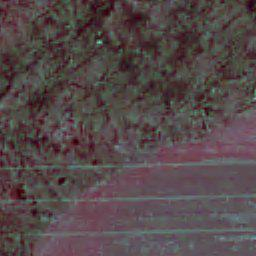

In [5]:
# sample train image
train_image_name_0 = train_dataset['filename'][0]
train_image_0 =  io.BytesIO(train_dataset['tif'][0])
print(f'Image name: {train_image_name_0}.tif')
Image.open(train_image_0)

Image name: 1016_10_1.tif


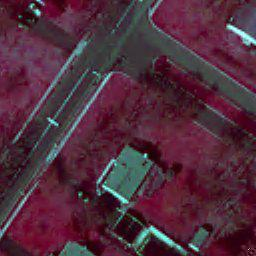

In [6]:
# sample validation image
val_image_name_0 = val_dataset['filename'][0]
val_image_0 =  io.BytesIO(val_dataset['tif'][0])
print(f'Image name: {val_image_name_0}.tif')
Image.open(val_image_0)

## MileStone 2

In [ ]:
!pip install "ipywidgets>=7,<8"
!pip install flask-restx==1.2.0

In [7]:
import os
import leafmap
from samgeo import SamGeo, show_image, download_file, overlay_images, tms_to_geotiff
from PIL import Image

In [8]:
# use leaf map to select bounding box
m = leafmap.Map(center=[37.8713, -122.2580], zoom=17, height="800px")
m.add_basemap("SATELLITE")
m

Map(center=[37.8713, -122.258], controls=(ZoomControl(options=['position', 'zoom_in_text', 'zoom_in_title', 'z…

In [9]:
# get bounding box
if m.user_roi_bounds() is not None:
    bbox = m.user_roi_bounds()
else:
    bbox = [-122.2659, 37.8682, -122.2521, 37.8741]

In [10]:
# bounding box for our input image
bbox

[-122.2665, 37.8686, -122.2548, 37.8746]

In [11]:
# download input image using bounding box from Satellite source
image = "satellite.tif"
tms_to_geotiff(output=image, bbox=bbox, zoom=17, source="Satellite", overwrite=True)

Downloaded image 01/15
Downloaded image 02/15
Downloaded image 03/15
Downloaded image 04/15
Downloaded image 05/15
Downloaded image 06/15
Downloaded image 07/15
Downloaded image 08/15
Downloaded image 09/15
Downloaded image 10/15
Downloaded image 11/15
Downloaded image 12/15
Downloaded image 13/15
Downloaded image 14/15
Downloaded image 15/15
Saving GeoTIFF. Please wait...
Image saved to satellite.tif


Image name: satellite.tif


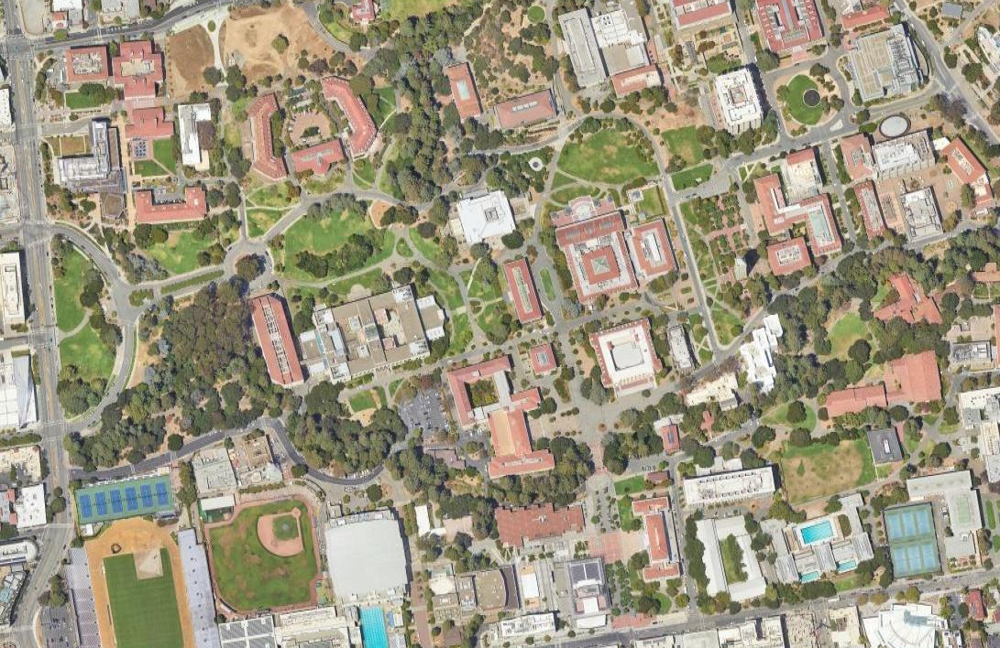

In [12]:
# Display the input image
print(f'Image name: satellite.tif')
Image.open(image)

In [15]:
# add input image onto the leaf map for visualization
m.layers[-1].visible = False
m.add_raster(image, layer_name="Image")
m

Map(bottom=6479458.0, center=[37.87129639254548, -122.25800514221193], controls=(ZoomControl(options=['positio…

### Initialize SAM model and generate segmentation masks

In [16]:
# download sam model at "sam_vit_h_4b8939.pth" check point
model_checkpoint = "sam_vit_h_4b8939.pth"
device = 'cuda' if torch.cuda.is_available() else 'cpu'
sam = SamGeo(
    model_type="vit_h",
    checkpoint = model_checkpoint,
    device=device,
    sam_kwargs=None,
)

Model checkpoint for vit_h not found.


Downloading...
From: https://dl.fbaipublicfiles.com/segment_anything/sam_vit_h_4b8939.pth
To: /root/.cache/torch/hub/checkpoints/sam_vit_h_4b8939.pth
100%|██████████| 2.56G/2.56G [00:37<00:00, 67.7MB/s]


In [17]:
# generate segmentation mask for the input image
sam.generate(image, output="masks.tif", foreground=True, unique=True)

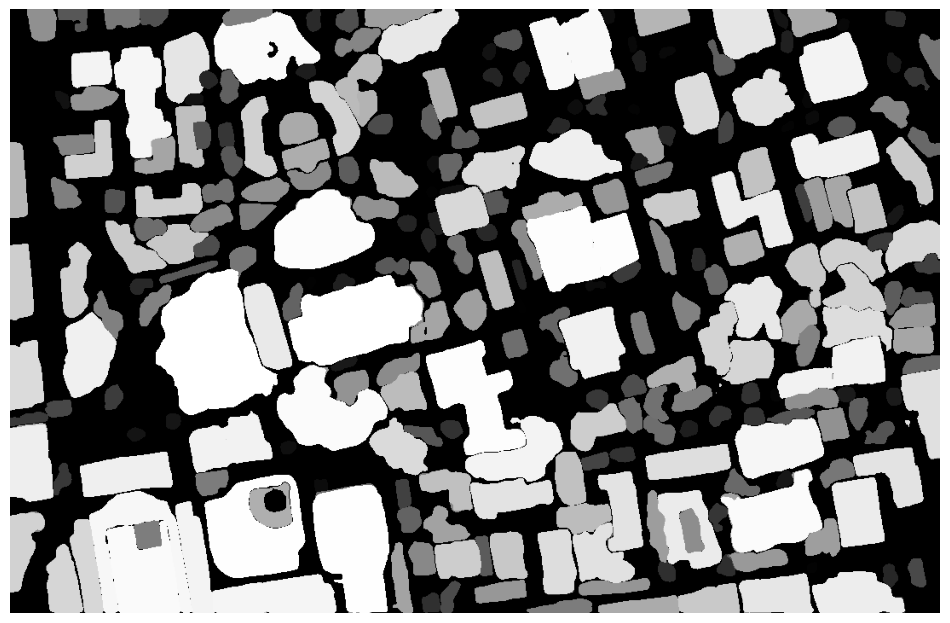

In [18]:
# show segmentation mask in gray scale
sam.show_masks(cmap="binary_r")

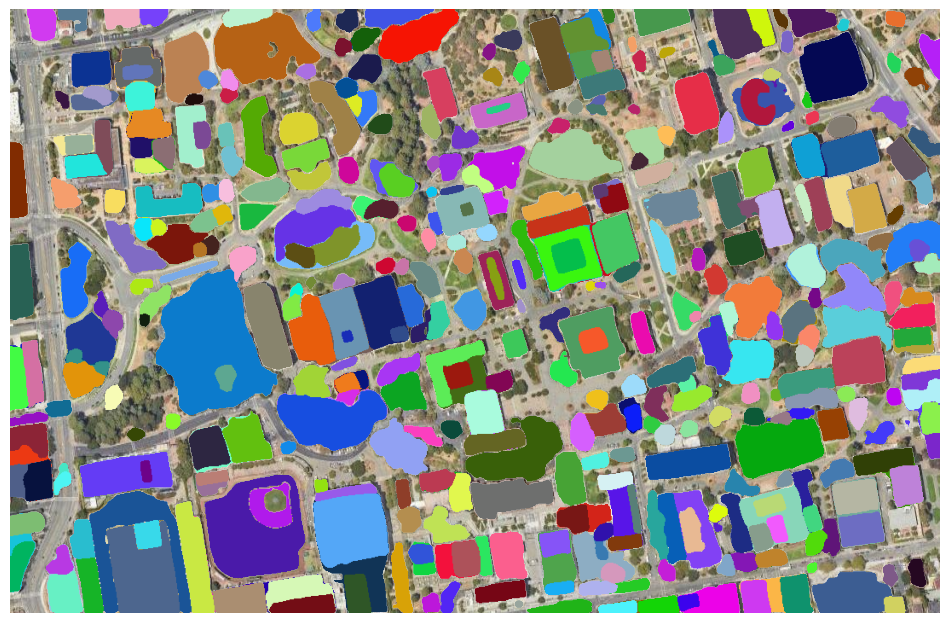

In [19]:
# show segmentation with annotations on the original image
sam.show_anns(axis="off", alpha=1, output="annotations.tif")


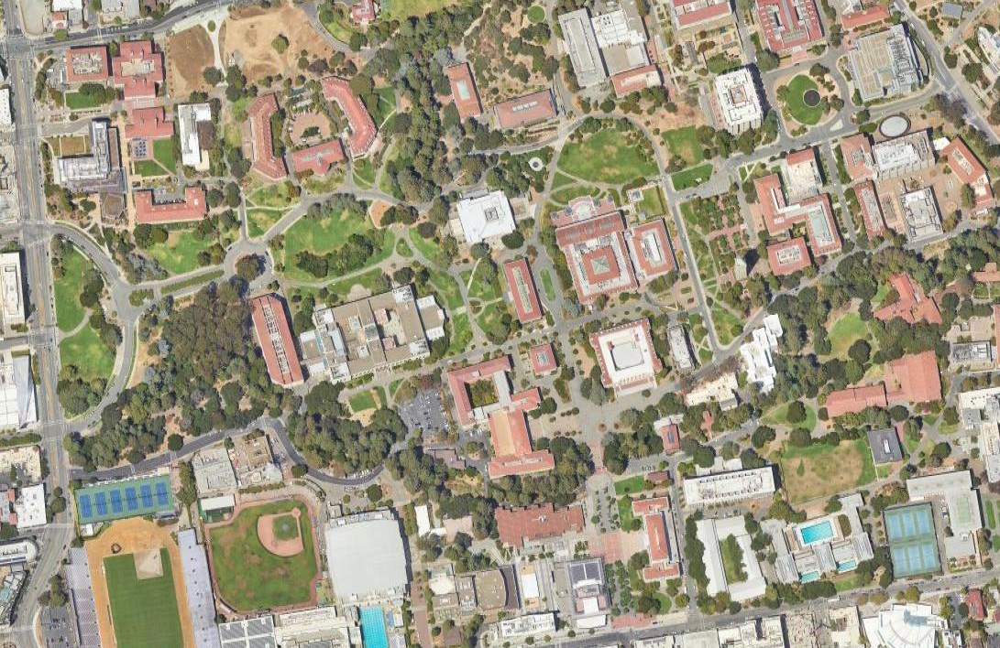
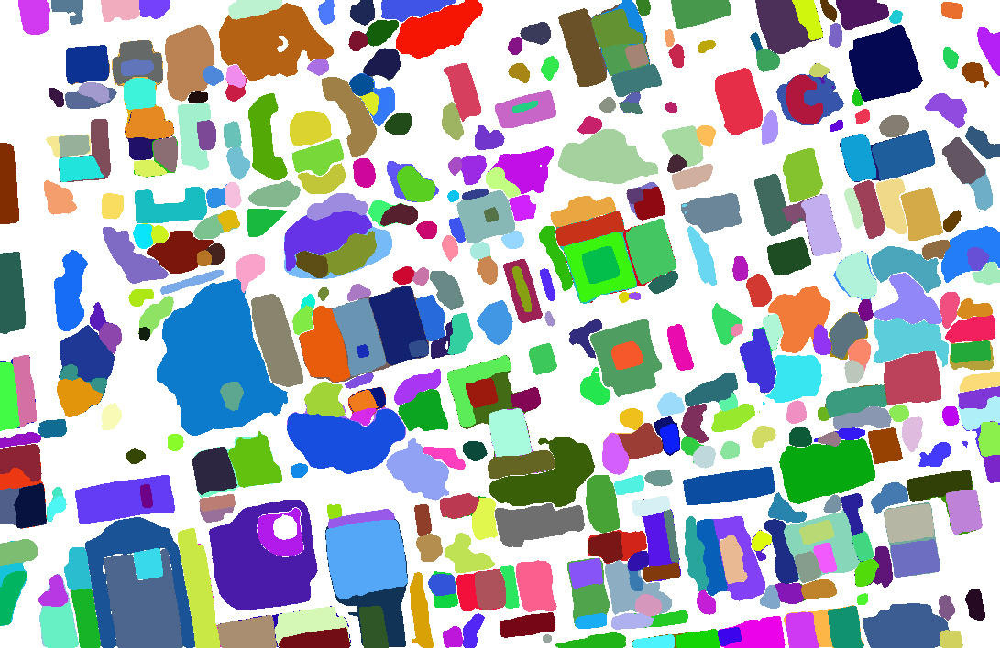

In [20]:
# compare input and segmentation results
leafmap.image_comparison(
    "satellite.tif",
    "annotations.tif",
    label1="Satellite Image",
    label2="Image Segmentation",
)

In [21]:
# add annotations onto the leaf map for visualization
m.add_raster("annotations.tif", alpha=0.5, layer_name="Masks")
m

Map(bottom=12958480.0, center=[37.87160128507345, -122.26046204566957], controls=(ZoomControl(options=['positi…

In [22]:
# mask to vector data
sam.tiff_to_vector("masks.tif", "masks.gpkg")

### Use tunable parameters in automatic mask generation

In [23]:
# Initialize tunable parameters to the SamGeo model
sam_kwargs = {
    "points_per_side": 32,
    "pred_iou_thresh": 0.86,
    "stability_score_thresh": 0.92,
    "crop_n_layers": 1,
    "crop_n_points_downscale_factor": 2,
    "min_mask_region_area": 100,
}

In [24]:
# download sam model at "sam_vit_h_4b8939.pth" check point with tuned parameters
model_checkpoint = "sam_vit_h_4b8939.pth"
device = 'cuda' if torch.cuda.is_available() else 'cpu'
sam = SamGeo(
    model_type="vit_h",
    checkpoint = model_checkpoint,
    device=device,
    sam_kwargs=sam_kwargs,
)

In [25]:
# generate segmentation mask for the input image
sam.generate(image, output="masks2.tif", foreground=True)

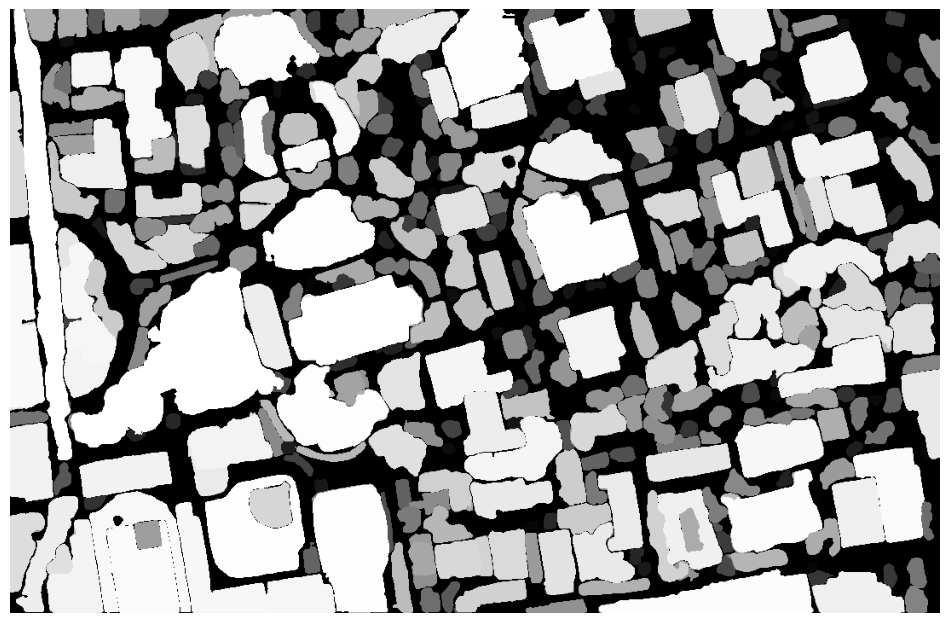

In [27]:
# show segmentation mask in gray scale
sam.show_masks(cmap="binary_r")

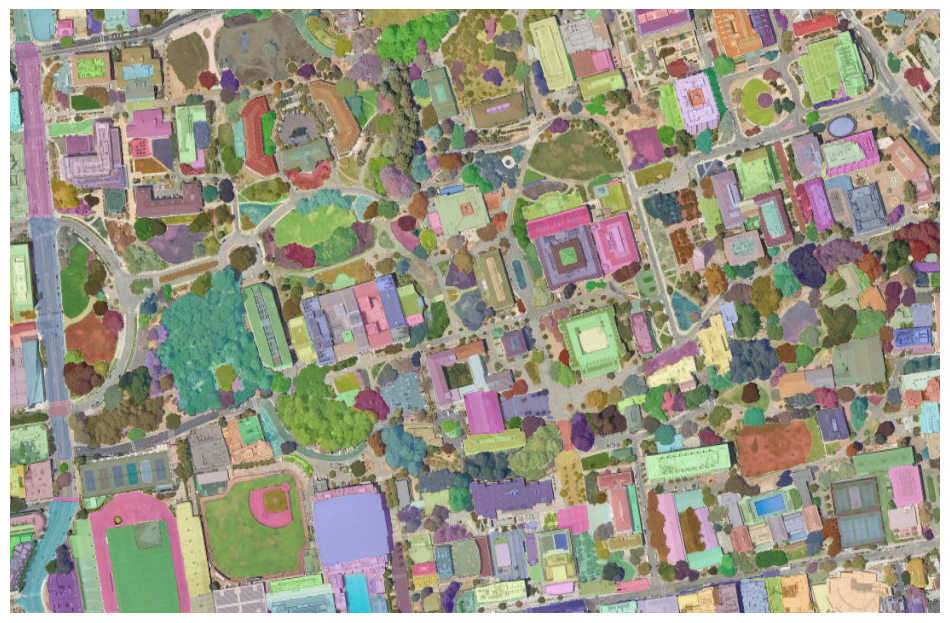

In [28]:
# show segmentation with annotations on the original image
sam.show_anns(axis="off", opacity=1, output="annotations2.tif")


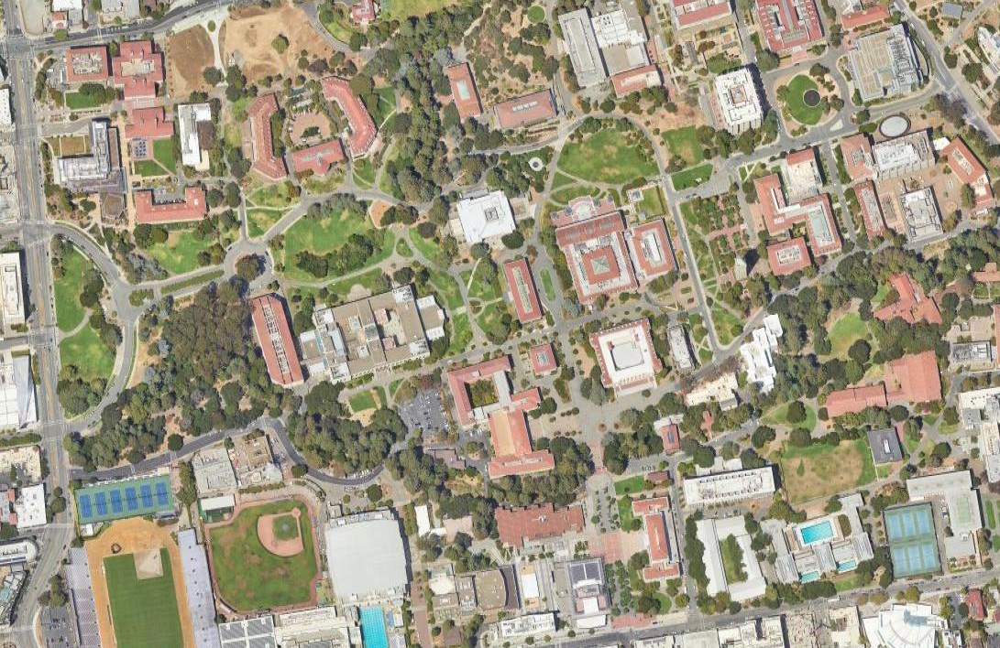
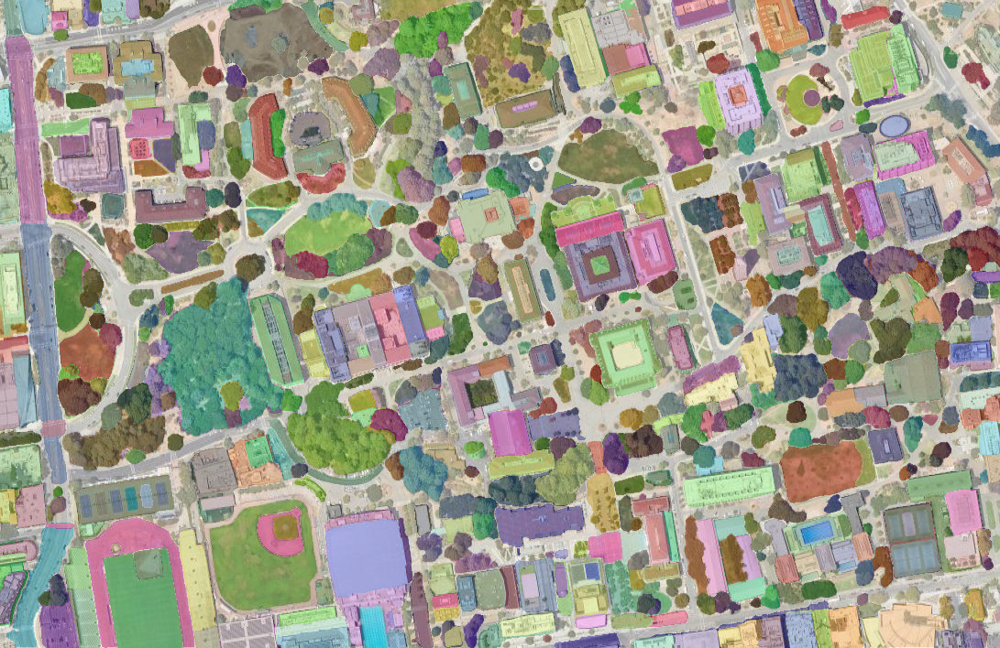

In [30]:
# compare input and segmentation results
leafmap.image_comparison(
    image,
    "annotations2.tif",
    label1="Image",
    label2="Image Segmentation",
)

In [31]:
# mask to vector data
sam.tiff_to_vector("masks2.tif", "masks2.gpkg")